In [18]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from nltk.tokenize import RegexpTokenizer
from nltk import FreqDist
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import cross_val_score
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
from nltk.tokenize import sent_tokenize
import scipy as sp
from sklearn.metrics import plot_confusion_matrix, classification_report
from sklearn.datasets import make_classification
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelEncoder
from gensim.models import word2vec
from nltk import word_tokenize
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from scipy.sparse import csr_matrix
import json
from collections import Counter
from keras.preprocessing.text import Tokenizer
import pickle
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential
import keras
from keras.layers import Dropout, Activation, Bidirectional, GlobalMaxPool1D, Input, Dense, LSTM, Embedding
import lime
import sklearn
import sklearn.ensemble
import sklearn.metrics
from sklearn.pipeline import make_pipeline
import shap
from wordcloud import WordCloud
import os
import tensorflow as tf
import tensorflow_datasets as tfds
from tensorboard.plugins import projector
try:
    %tensorflow_version 2.x
except Exception:
    pass

%load_ext tensorboard

shap.initjs()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


# Summary

**The goal of the project is to create a model that can accurately classify articles from the Guardian newspaper into one of 24 pre-defined categories, depending on the subject matter.**<br>
**I chose the Guardian as it has a free-to-use API with very few call restrictions, so theoretically you could retrieve every article the paper has in its archive. I decided to download around 10 years of stories; firstly because that amounted to around 700,000 articles, which is at the upper end of what I can operate with on my local computer and secondly, stories older than 10 years might introduce errors into the model. For instance, the name Klitschko would, 10 years ago, suggest a sport story, whereas more recently it would indicate a politics story. The code for the API calls is in the [DataCollection notebook](DataCollection.ipynb).**<br>
**The response object contains various metadata tags, including the category tag.**<br>
**It was clear from the beginning that the biggest challenge was going to be dealing with a larger dataset, and that I'd need to be more careful in planning the workflow.**<br>
**This meant stripping down the dataset to only features that would be most useful for feature engineering, such as wordcount, byline and publication date, along with the essential features of body text ("bodyText") and the category tag ("sectionId").**<br>
**I made a dataframe of just text, tag and wordcount and filtered out any unusual categories, eg crosswords, puzzles, leaving me with 24. I also checked for Nans and filtered out any articles with very small word counts, leaving around 500k records, and saved it to my local machine. All of this code is in the [Sample10k notebook](Sample10k.ipynb).**<br>
**This was still to big for me to work with, so the overall strategy was to take a random sample of 10k stories, fit various models and tune them. I'd then find out the max size of dataset I can work with, and focus on the best performing models and processing techniques gleaned from the 10k sample.**<br>
**In addition, I would fit neural network models onto the large dataset as the sample is too small to give me useful results.**

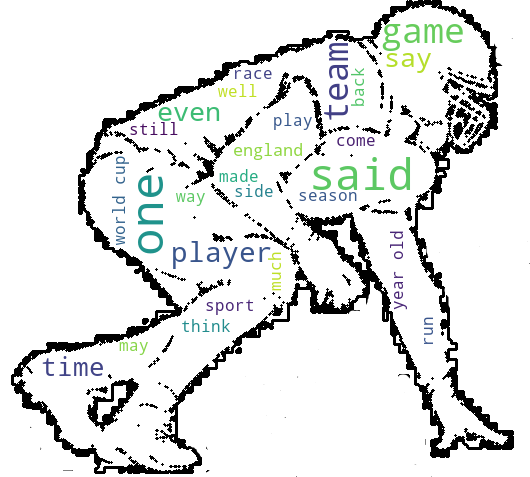

**The plan was to make a baseline Naive-Bayes model using tf/idf vectorization as a baseline then try different processing techniques to find the most effective vectorization parameters. This included removing stopwords, stemming the text, trying different size vocabularies, making a sentence size column, using bigrams and also extracting named entities and making columns of those most commonly encountered (this proved to be unsuccessful and I deleted the code to try and limit the size of the notebook, but it is saved elsewhere and I can send if needed).**<br>
**I used crossvalidation on the set to evaluate, and also performed train test split to get a final score on a test sample.**
**The best vector would then be fed into other model types such as Support Vector, Random Forest, GradBoost and Logistic Regression.**<br>
**For the sample set, I also vectorized using pre-trained W2Vec glove matrix and fed that into the aforementioned models. With the full set, I used the glove matrix as the embedding layer in a neural network, and also ran a neural network where the model learned its own embedding matrix.**<br>
**After trial and many errors, I found 250k was the maximum size of dataset I could work with, although I encountered problems in Jupyter trying to implement the same initial cleaning and processing methods I used on the sample set. I therefore tried to create the initial dataframe using a python file, which was successful. The file did, however, seem to cause issues when stored in the main directory, so it has not been included (it is essentially the same as the processing code in the Sample10k nb), but can be sent over if needed.**<br>
**At many points during the process, I saved large files after processing/fitting etc in order to not have to rerun the process every time. These aren't included in the Git repo as they are too big, all I have included is the raw 10k sample json file along with the fitted neural network models from the large dataset, and links to the [glove files](https://nlp.stanford.edu/projects/glove/). Everything is repeatable using only these.**<br>
**The tf/idf models had the advantage that I could use the SHAP and LIME libraries to explain the models in terms of the words fed into them, potentially providing various insights into threads that run through the categories. It also opens up the possibility of modeling against other target features to find more hidden commonalities. The model could, say, be linked to Twitter analytics to try and tease out features of viral stories, or to byline to find out the style of successful writers.**<br>
**I was able to do something similar with the neural networks using tensorboard to produce visualisations of the linguistic similarities learned between words. Using weights purely learned on the Guardian corpus gives us the purest idea of how the newspaper reports various topics, but is a bit erratic due to the relatively small dataset it is trained on.**<br>
**The model that used GloVe (trained on the whole Wikipedia corpus) as the initial embedding weights strikes more of a balance between general word usage and Guardian word usage. Comparing the learned embedded layer weights to the initial GloVe weights gives you an idea of how the Guardian's use of language differs from general usage (or at least usage on Wikipedia).**<br>
**There are many more avenues I would have explored with more computing power and time, mainly in tuning the neural network parameters (I only really had time for one shot on each), using bigger pre-trained embedding vectors and in feature engineering.**<br> 
**For instance, I suspect that named entities could prove to be useful, but would need quite a lot of refining and more resources.<br>**
**The process up until the Neural Networks is basically the same as in the Sample10k notebook, and the markdown notes there explain it. There are some notes here in the tf/idf Logistic Regression section to explain the use of SHAP and LIME explainers, and then the next notes are in the Neural Network section.**<br>


# Global variables/functions

In [2]:
labels_nn=['artanddesign', 'australia-news', 'books', 'business', 'culture', 'education', 'environment',
        'film', 'food', 'football', 'lifeandstyle', 'media', 'money', 'music', 'politics', 'science',
        'society', 'sport', 'stage', 'technology', 'tv-and-radio', 'uk-news', 'us-news', 'world']

In [3]:
def make_confusion_matrix(model, X, y, model_type):
    '''makes confusion matrix using model predicted v real results'''
    base_predictions = model.predict(X)
    cm = confusion_matrix(y, base_predictions)
    cmp = ConfusionMatrixDisplay(confusion_matrix=cm, 
                              display_labels=labels_nn)
    x_list = labels_nn
    fig, ax = plt.subplots(figsize=(20,20))
    ax.yaxis.set_ticklabels(x_list, fontsize=20);
    ax.xaxis.set_ticklabels(x_list, rotation=45, fontsize=20);
    cmp.plot(ax=ax, xticks_rotation='vertical')
    plt.savefig(f"Viz/{model_type}.png")


In [12]:
def make_class_report(model, X, y):
    base_predictions = model.predict(X)
    return classification_report(y, base_predictions, digits=3)

In [4]:
def stem_and_tokenize(document):
    '''takes in document, stems and tokenises'''
    tokens = tokenizer.tokenize(document)
    return [stemmer.stem(token) for token in tokens]

In [5]:
def remove_stopwords(token_list):
    '''takes in tokenised list and removes stop words'''
    stopwords_removed = [token for token in token_list if token not in stopwords_list]
    return stopwords_removed

In [6]:
# load the full dataset train, test dfs
X250_train = pd.read_csv('data/X250_train_full.csv')

In [7]:
X250_test = pd.read_csv('data/X250_test_full.csv')

In [8]:
y250_train = pd.read_csv('data/y250_train_full.csv')

In [9]:
y250_test = pd.read_csv('data/y250_test_full.csv')

In [10]:
# load the final vectors fitted on the full train set
loader = np.load('data/tfidf250_stem_final.npz')
X250_train_vector_final = csr_matrix((loader['data'], loader['indices'], loader['indptr']),
                      shape=loader['shape'])

In [11]:
loader_test = np.load('data/test_stem_final.npz')
X250_test_vector_final = csr_matrix((loader_test['data'], loader_test['indices'], loader_test['indptr']),
                      shape=loader_test['shape'])

# Make tfidf vector/baseline model

In [7]:
tfidf_base = TfidfVectorizer(max_features=1000)
X250_train_vector_base = tfidf_base.fit_transform(X250_train["bodyText"])

# Visually inspect the vectorized data
pd.DataFrame.sparse.from_spmatrix(X250_train_vector_base, columns=tfidf_base.get_feature_names())

,000,10,100,11,12,13,14,15,16,17,...,wrong,wrote,year,years,yes,yet,york,you,young,your
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.034202,0.000000,0.0,0.0,...,0.000000,0.00000,0.016347,0.018123,0.0,0.00000,0.139066,0.050603,0.000000,0.000000
1,0.022295,0.043382,0.000000,0.000000,0.000000,0.0,0.000000,0.027607,0.0,0.0,...,0.000000,0.00000,0.014660,0.032504,0.0,0.00000,0.000000,0.000000,0.100095,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.000000,0.00000,0.000000,0.000000,0.0,0.00000,0.000000,0.321290,0.000000,0.464400
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.000000,0.00000,0.043488,0.000000,0.0,0.00000,0.000000,0.000000,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.034400,0.031699,0.0,0.035825,0.000000,0.0,0.0,...,0.072842,0.00000,0.000000,0.075930,0.0,0.00000,0.000000,0.070673,0.000000,0.025538
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,0.099993,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.000000,0.00000,0.043834,0.024297,0.0,0.00000,0.000000,0.000000,0.000000,0.000000
199996,0.000000,0.000000,0.000000,0.010885,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.011525,0.00000,0.010836,0.018020,0.0,0.02535,0.023047,0.301902,0.000000,0.040405
199997,0.029298,0.057011,0.039851,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.000000,0.00000,0.000000,0.000000,0.0,0.00000,0.040973,0.059637,0.000000,0.000000
199998,0.000000,0.012502,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,...,0.017972,0.00000,0.016899,0.037468,0.0,0.00000,0.017970,0.078467,0.028845,0.025204


In [22]:
# Instantiate a MultinomialNB classifier
baseline_model = MultinomialNB()


In [ ]:
# Evaluate the classifier on X_train_vectorized and y_train
baseline_cv = cross_val_score(baseline_model, X250_train_vector_base, y250_train['sectionId'])
baseline_cv

# Stopword/stemmed

In [22]:
stopwords_list = stopwords.words('english')

In [23]:
basic_token_pattern = r"(?u)\b\w\w+\b"
tokenizer = RegexpTokenizer(basic_token_pattern)

In [24]:
stemmer = SnowballStemmer(language="english")

In [25]:
stemmed_stopwords = [stemmer.stem(word) for word in stopwords_list]

In [ ]:
tfidf250_stem = TfidfVectorizer(
    max_features=1000,
    stop_words=stemmed_stopwords,
    tokenizer=stem_and_tokenize
)

# Fit the vectorizer on X_train["text"] and transform it
X250_train_vector_stem = tfidf250_stem.fit_transform(X250_train["bodyText"])

In [ ]:
stemmed250_cv = cross_val_score(baseline_model, X250_train_vector_stem, y250_train['sectionId'])
stemmed250_cv

## final model

### Can preload vector and ignore following code

In [ ]:
tfidf250_stem_final = TfidfVectorizer(
    max_features=2000,
    stop_words=stemmed_stopwords,
    tokenizer=stem_and_tokenize)

X250_train_vector_stem_final = tfidf250_stem_final.fit_transform(X250_train["bodyText"])

In [ ]:
X250_test_vector_final = tfidf250_stem_final.transform(X250_test["bodyText"])

In [ ]:
np.savez('data/tfidf250_stem_final', data=X250_train_vector_stem_final.data, 
         indices=X250_train_vector_stem_final.indices,
         indptr=X250_train_vector_stem_final.indptr, 
         shape=X250_train_vector_stem_final.shape)

In [ ]:
np.savez('data/test_stem_final', data=X250_test_vector_final.data, 
         indices=X250_test_vector_final.indices,
         indptr=X250_test_vector_final.indptr, 
         shape=X250_test_vector_final.shape)

### Make model

In [13]:
nb_model = MultinomialNB()

In [14]:
sentsize250_final = cross_val_score(nb_model, X250_train_vector_final, y250_train['sectionId'])
sentsize250_final

array([0.725925, 0.7236  , 0.725225, 0.72505 , 0.72655 ])

In [15]:
nb_model = MultinomialNB()
nb_model.fit(X250_train_vector_final, y250_train['sectionId'])
nb_model.score(X250_train_vector_final, y250_train['sectionId'])

0.72873

In [16]:
nb_model.score(X250_test_vector_final, y250_test['sectionId'])

0.72214

In [19]:
print(make_class_report(nb_model, X250_test_vector_final, y250_test['sectionId']))

                precision    recall  f1-score   support

  artanddesign      0.691     0.769     0.728       888
australia-news      0.785     0.637     0.703      2564
         books      0.723     0.770     0.746      2022
      business      0.656     0.776     0.711      2785
       culture      0.684     0.130     0.219       699
     education      0.764     0.728     0.746       858
   environment      0.604     0.683     0.641      1767
          film      0.768     0.854     0.809      2136
          food      0.731     0.712     0.721       732
      football      0.957     0.930     0.943      4377
  lifeandstyle      0.545     0.659     0.596      2285
         media      0.723     0.562     0.633      1476
         money      0.768     0.580     0.661       933
         music      0.802     0.898     0.847      2723
      politics      0.714     0.747     0.730      2555
       science      0.685     0.468     0.556       727
       society      0.567     0.579     0.572  

<ipython-input-2-979cc80c55c4>:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.xaxis.set_ticklabels(x_list, rotation=45);


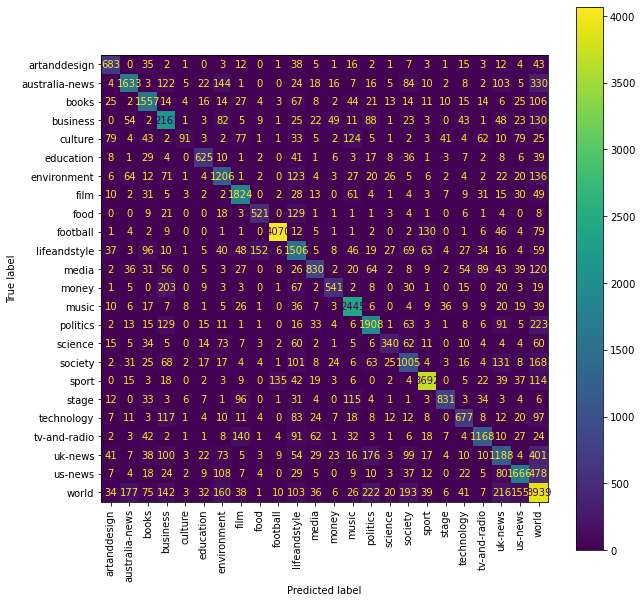

In [27]:
make_confusion_matrix(nb_model, X250_test_vector_final, y250_test['sectionId'])

# Other models

## Logistic

In [20]:
with open('data/lr_model.pkl', 'rb') as inp:
    lr_model = pickle.load(inp)

### Make/fit model

In [60]:
lr_model = LogisticRegression(C=3, solver='liblinear')
lr_model.fit(X250_train_vector_final, y250_train['sectionId'])
lr_model.score(X250_train_vector_final, y250_train['sectionId'])

0.816195

In [21]:
lr_model.score(X250_test_vector_final, y250_test['sectionId'])

0.78934

In [22]:
print(make_class_report(lr_model, X250_test_vector_final, y250_test['sectionId']))

                precision    recall  f1-score   support

  artanddesign      0.763     0.787     0.775       888
australia-news      0.794     0.838     0.815      2564
         books      0.820     0.824     0.822      2022
      business      0.755     0.762     0.758      2785
       culture      0.646     0.308     0.417       699
     education      0.791     0.803     0.797       858
   environment      0.693     0.732     0.712      1767
          film      0.846     0.884     0.865      2136
          food      0.739     0.775     0.757       732
      football      0.959     0.969     0.964      4377
  lifeandstyle      0.673     0.681     0.677      2285
         media      0.772     0.684     0.725      1476
         money      0.773     0.714     0.742       933
         music      0.863     0.913     0.887      2723
      politics      0.758     0.782     0.770      2555
       science      0.712     0.633     0.670       727
       society      0.659     0.634     0.647  

**We are already seeing much better precision/recall performance, especially in the important categories. The very low recall score for culture is the only really glaring problem. Unsurprising given it is an umbrella term form many other categories**

<ipython-input-297-6689025c27ea>:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.yaxis.set_ticklabels(x_list, fontsize=20);
<ipython-input-297-6689025c27ea>:9: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.xaxis.set_ticklabels(x_list, rotation=45, fontsize=20);


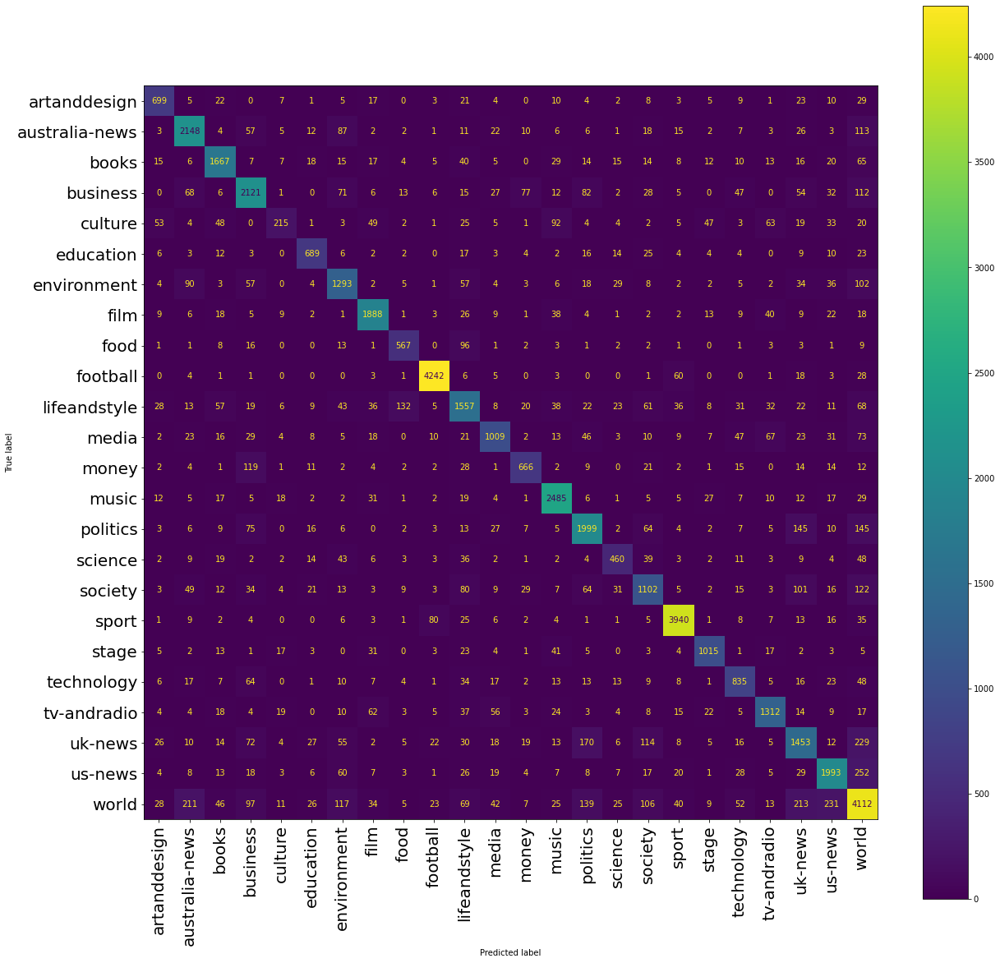

In [298]:
make_confusion_matrix(lr_model, X250_test_vector_final, y250_test['sectionId'], 'log_res')

#### save model

In [121]:
with open('data/lr_model.pkl', 'wb') as file:
    pickle.dump(lr_model, file)


### Notes on SHAP and LIME

**Given the good performance of this model, it made sense to take advantage of its relatively simple inputs and parameters to analyze which words were most decisive in predicting the category. LIME is good for analyzing individual articles, whereas SHAP allows you to take the mean scores over whatever subsample you select, so you can analyze over the whole dataset and the each category individually**<br>
**Lime requires that you pass raw text into an sklearn pipeline consisting of a vectorizer and the model, so I fitted the final vectorizer again and pickled it for reuse.**<br>
**I then picked the first article from each category that the model correctly predicted the result, got their indices and passed them into LIME's explainer instance method. It returns the most important six words in making the prediction, giving a value for each word of how much probability it added to the result.**<br>
**I only had time to look at a few individual samples, but even from that it seems that it generates interesting results with many potential applications.**<br>
**Producing the SHAP visualizations was a little more involved as it's not really set up to deal with multiclass outputs (the inbuilt visualizations expect 1d or 2d outputs, not the 24 we have). In order to produce visualizations I need to use the shap values tensor returned by the explainer object. This contains shap values for each word in each sample (I had to limit it to 10k for memory purposes).**<br>
**To get the mean shap score for each word in individual categories, I filtered the dataset, retrieved the indices and then selected those rows of the shap values tensor. I averaged the scores for each word across each of those records (the indices of the words are the same as the columns of the tf/idf matrix), sorted and selected the top 20 words and plotted as a bar chart.** <br>
**I then summed all the words across each category and found the mean in order to plot a bar chart across the whole sample set.**<br>
**Again, it gave results that were useful in establishing threads within each category. It also has potential applications beyond those tackled in this project.**<br>


### LIME analysis on individual samples

#### open files and reconstruct vectorizer


In [33]:
with open('data/final_vectorizer.pk', 'rb') as inp:
    vector_lime = pickle.load(inp)

#### Make vectorizer and save

In [ ]:
vectorizer = TfidfVectorizer(max_features=2000,
                             stop_words=stemmed_stopwords,
                             tokenizer=stem_and_tokenize)

In [97]:
vectorizer.fit_transform(X250_train["bodyText"])

<200000x2000 sparse matrix of type '<class 'numpy.float64'>'
	with 37133277 stored elements in Compressed Sparse Row format>

In [287]:
with open('data/final_vectorizer.pk', 'wb') as fin:
    pickle.dump(vectorizer, fin)

#### lime analysis

In [289]:
c = make_pipeline(vector_lime, lr_model)

In [234]:
from lime.lime_text import LimeTextExplainer
explainer = LimeTextExplainer(class_names=labels_nn)

In [235]:
index_list_10 =[25, 7, 5, 2, 17, 30, 34, 63, 1, 0]
lab=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23]
top_ten={'world': 23, 'football': 9, 'sport': 17, 'music': 13, 'australia-news': 1,
         'business': 3, 'politics': 14, 'us-news': 22, 'film': 7, 'books':2}
class_names=labels_nn

In [290]:
for ind in index_list_10:
    exp = explainer.explain_instance(X250_test.loc[ind, 'join_nostop'], c.predict_proba, num_features=6, top_labels=1)
    exp.show_in_notebook(text=False)

### SHAP analysis across many samples

In [ ]:
# get words from idfd vectorizer and sort
cols=sorted(list(vector_lime.vocabulary_.keys()))

In [57]:
# make sparse final vector into pd dataframe with words as col titles
shap_train_df = pd.DataFrame(X250_train_vector_final.toarray(), columns = cols)
shap_test_df = pd.DataFrame(X250_test_vector_final.toarray(), columns = cols)

In [307]:
# make SHAP explainer object  on 10k records in test set
masker_log = shap.maskers.Independent(data=shap_train_df)
explainer_log = shap.LinearExplainer(lr_model, masker=masker_log)
shap_val = explainer_log(shap_test_df[0:10000])

In [308]:
shap_val_3d = shap_val.values

In [311]:
# map each category to index, 
# make a dictionary, with categories as keys
# and a ,2000 (2000 word vocab) array as value, to hold the summed shap values for each word of each record predicted for each category

cat_ind_map={}
num_cats_pred = {}
mean_shap_cat = {}
for cat in labels_nn:
    cat_ind_map[cat] = labels_nn.index(cat)
    num_cats_pred[cat] = 0
    mean_shap_cat[cat] = np.zeros(2000)

In [ ]:
# go through each record and find how many predictions for each category
# add each record's shap values to the relevant array in the dictionary 

row_idx=0
for record in shap_val_3d:
    pred_result = lr_model.predict(X250_test_vector_final[row_idx])[0]
    num_cats_pred[pred_result] +=1
    cat_index = cat_ind_map[pred_result]  
    selected_cat = rec[ :, cat_index]
    mean_shap_cat[pred_result] += selected_cat
    row_idx+=1   

In [313]:
# divide each array in the dict by the number predictions for that category to find mean shap value for each word in each cat
for pred_label in mean_shap_cat:
    mean_shap_cat[pred_label] /= num_cats_pred[pred_label]

In [314]:
shap_dic_sorted = {}

In [315]:
#sort the dictionaries by value in array, need to map the shap value to the actual text word to keep track when sorting
for cat in labels_nn:
    internal_dic = {}
    idx_w=0
    for word in mean_shap_cat[cat]:
        text_word = cols[idx_w]
        internal_dic[text_word] = word
        idx_w += 1
    sortlist = sorted(internal_dic.items(), key=lambda x:x[1], reverse=True)
    sortdict = dict(sortlist)
    shap_dic_sorted[cat] = sortdict

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


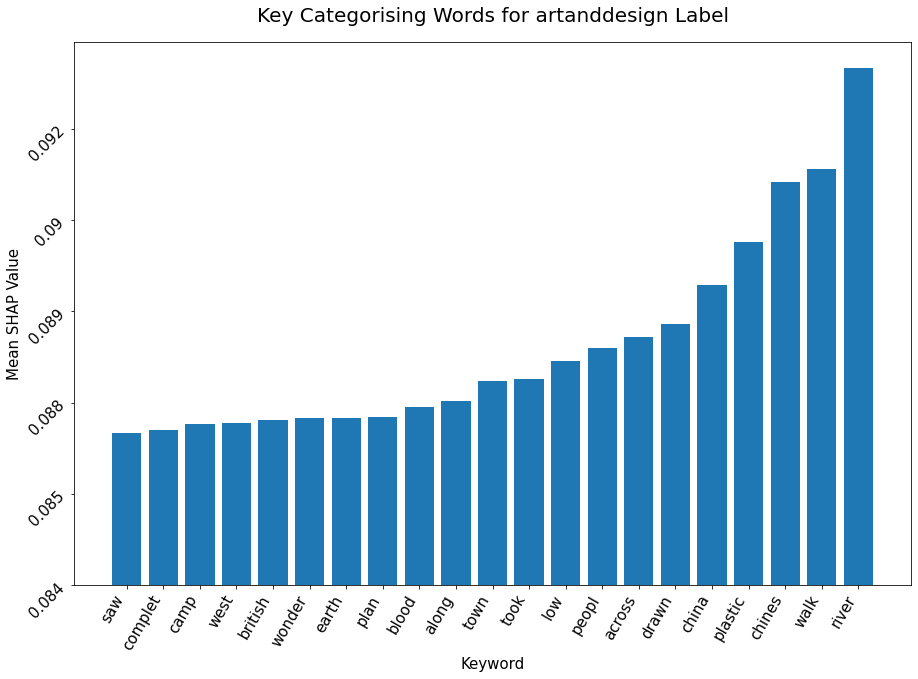

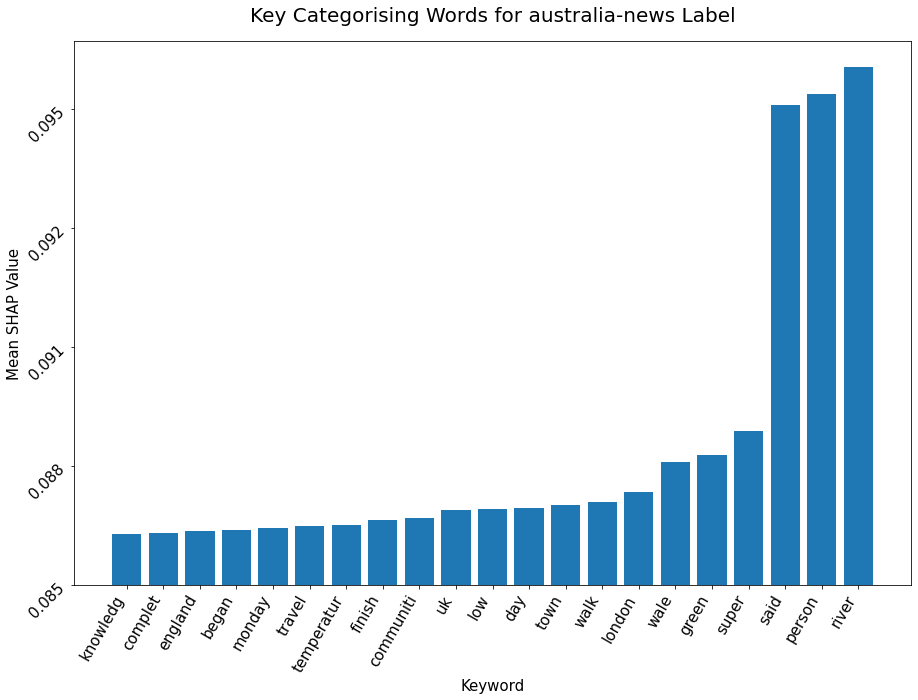

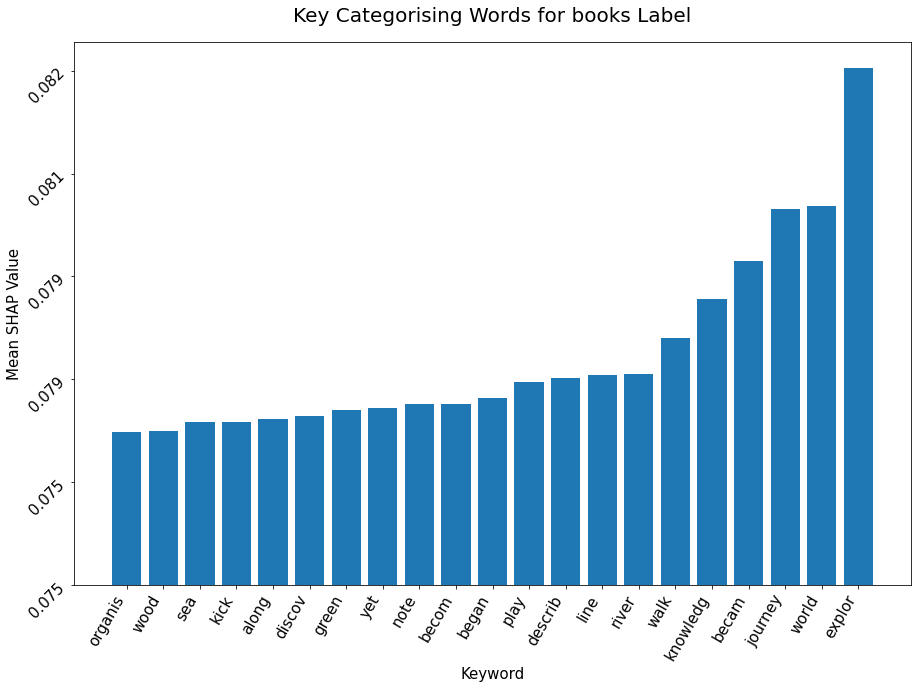

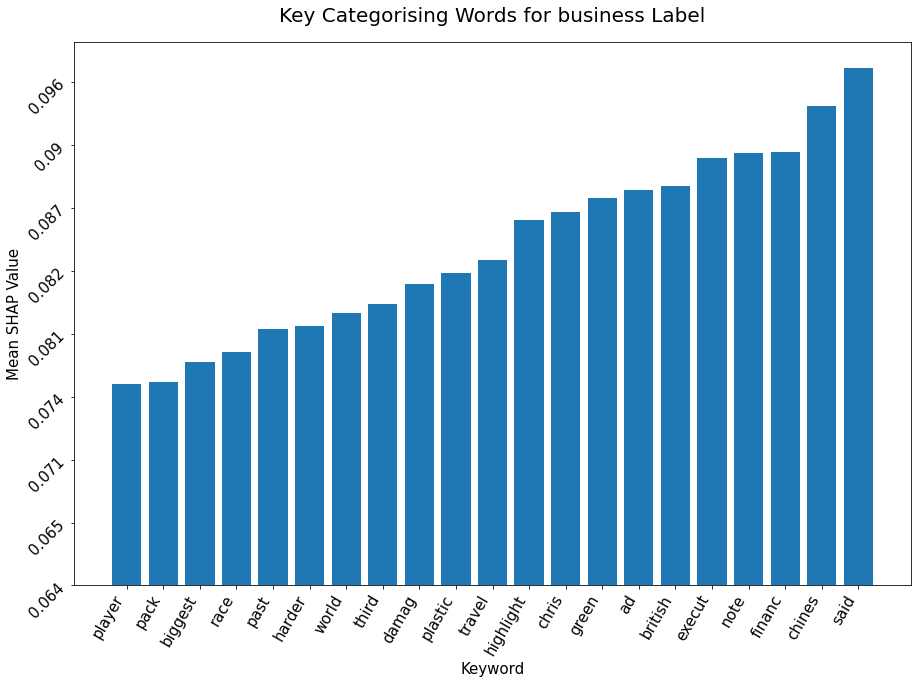

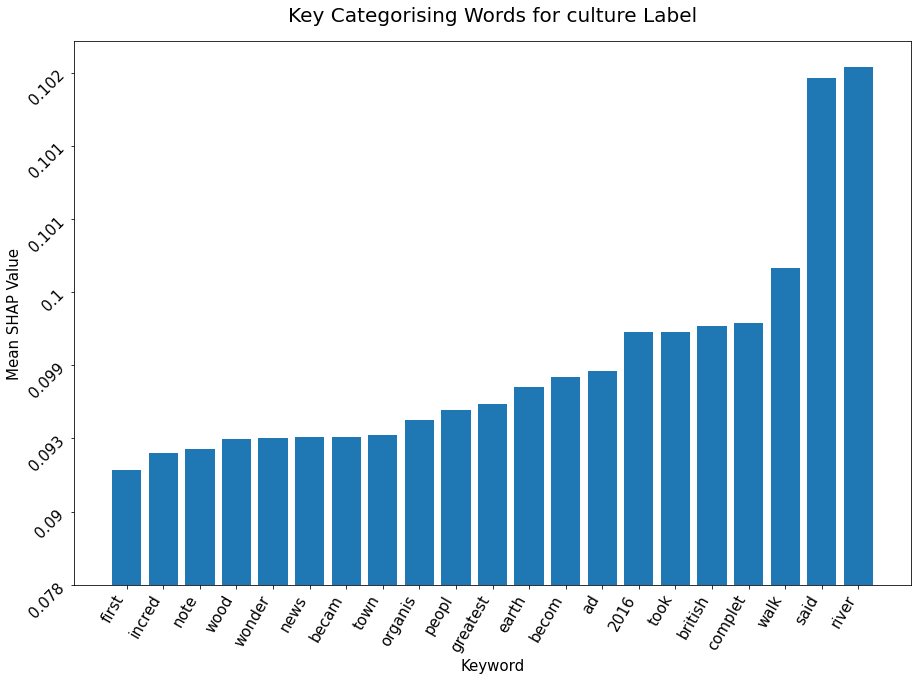

...

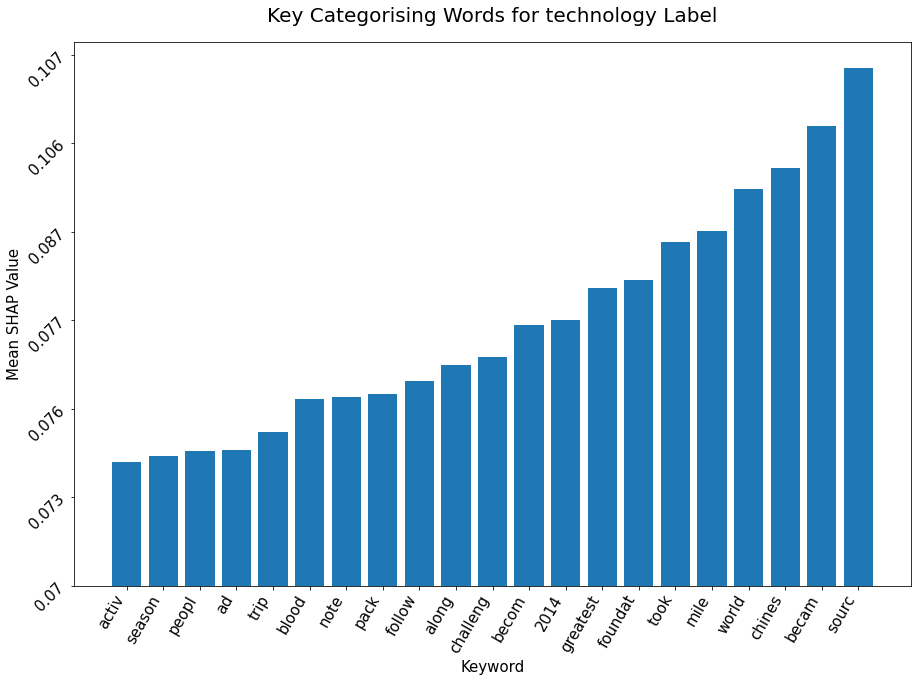

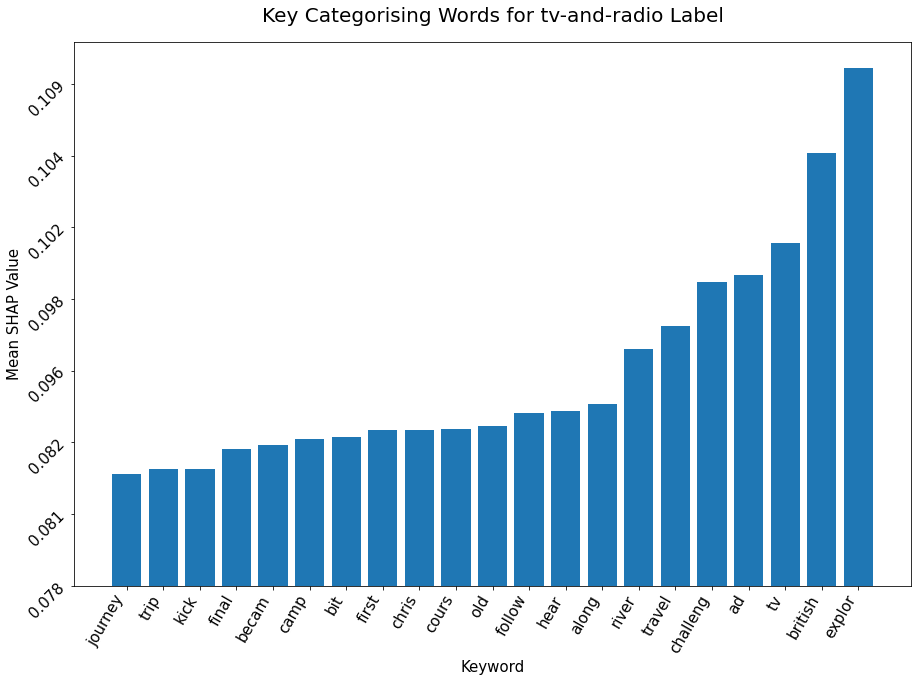

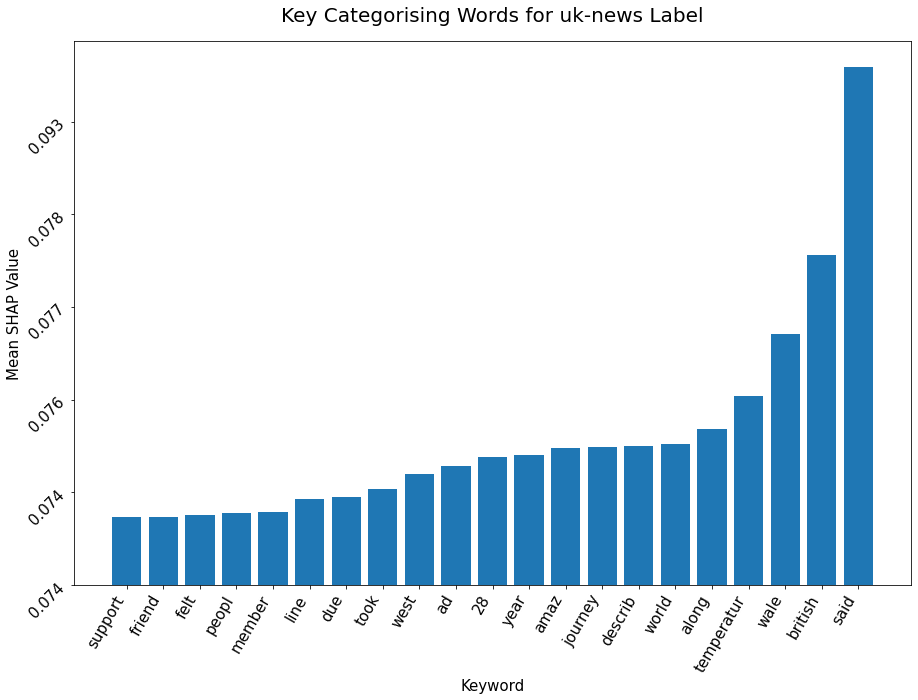

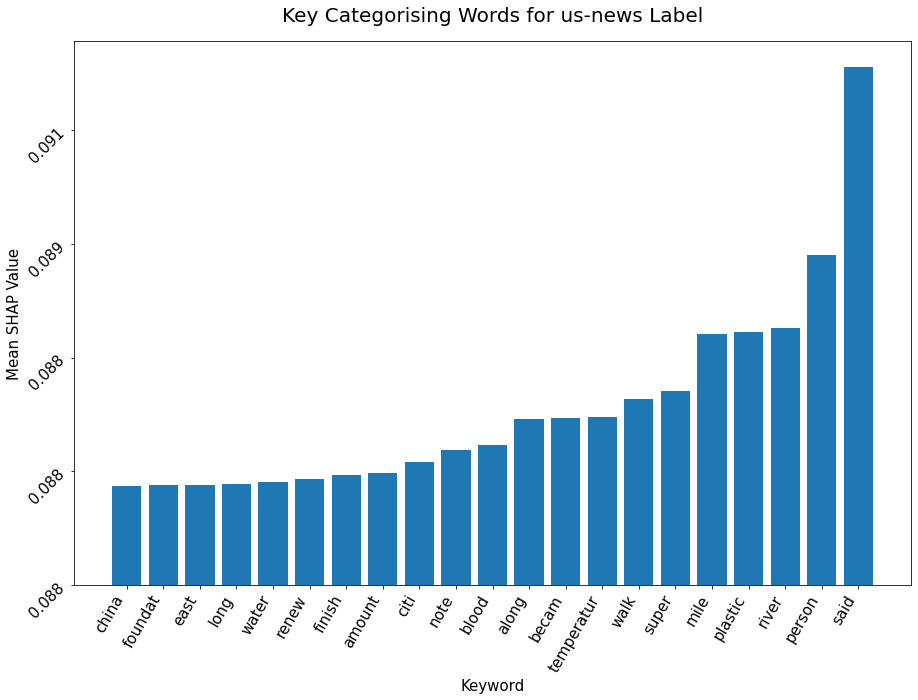

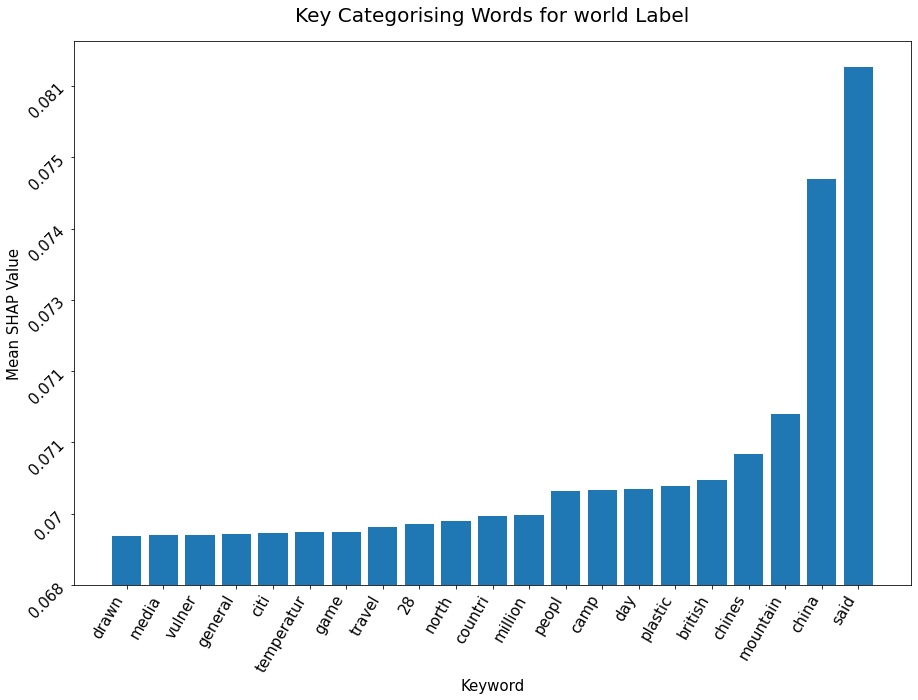

In [316]:
# select top 20 words for each category and plot as bar chart
for dic in shap_dic_sorted:  
    ll = sorted(shap_dic_sorted[dic].items(), key=lambda x:x[1], reverse=True)[:21]
    ll_dic = dict(ll)
    l = sorted(ll_dic.items(), key=lambda x:x[1])
    graph_dic = dict(l)
        # Set up plot and plot data
    fig, ax = plt.subplots(figsize=(15, 10))
    ax.bar(list(graph_dic.keys()), list(graph_dic.values()))

    # Customize plot appearance
    y_val=[round(gd, 3) for gd in graph_dic.values()][:-1]
    x_val = list(graph_dic.keys())
    ax.set_title(f'Key Categorising Words for {dic} Label', fontsize=20, pad = 20)
    ax.set_ylabel("Mean SHAP Value", fontsize=15)
    ax.set_xlabel("Keyword", fontsize=15)
    ax.yaxis.set_ticklabels(y_val, rotation= 45, fontsize=15)
    ax.xaxis.set_ticklabels(x_val, rotation=60, fontsize=15, ha='right')
    plt.savefig(f"Viz/{dic}_shap.png")
    plt.show();

In [319]:
# produce chart for the full 10k sample
overall_array=np.zeros(2000)
overall_dic = {}
for cat in mean_shap_cat:
    overall_array += mean_shap_cat[cat]
overall_array /= 24
ow_idx=0
for word in overall_array:
    word_text = cols[ow_idx]
    overall_dic[word_text] = word
    ow_idx+=1

o_sortlist = sorted(overall_dic.items(), key=lambda x:x[1], reverse=True)[:25]
overall_dic_sorted = dict(o_sortlist)
    

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


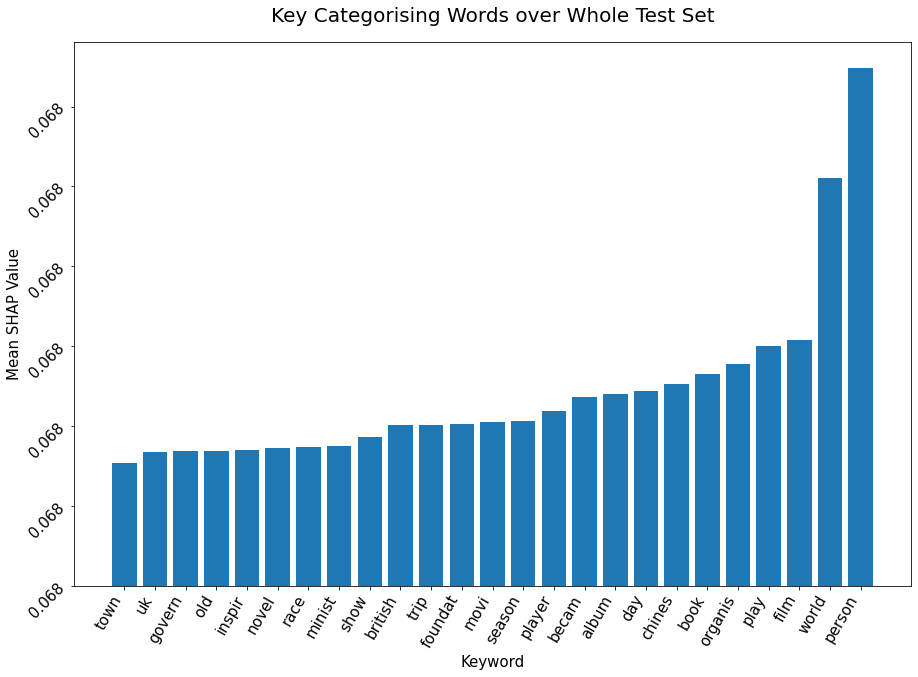

In [320]:
oall = sorted(overall_dic_sorted.items(), key=lambda x:x[1])
oall_dic = dict(oall)
fig, ax = plt.subplots(figsize=(15, 10))
ax.bar(list(oall_dic.keys()), list(oall_dic.values()))

# Customize plot appearance
y_val=[round(gd, 3) for od in oall_dic.values()]
x_val = list(oall_dic.keys())
ax.set_title(f'Key Categorising Words over Whole Test Set', fontsize=20, pad = 20)
ax.set_ylabel("Mean SHAP Value", fontsize=15)
ax.set_xlabel("Keyword", fontsize=15)
ax.yaxis.set_ticklabels(y_val, rotation= 45, fontsize=15)
ax.xaxis.set_ticklabels(x_val, rotation=60, fontsize=15, ha='right')
plt.savefig("Viz/ovall_shap.png")
plt.show();

In [310]:
with open('data/shap_val.pkl', 'wb') as inp:
    pickle.dump(shap_val_3d, inp)

## XGB

### load from memory

In [27]:
#open pre-trained model
with open('data/xgb_model.pkl', 'rb') as inp:
    xgb_model = pickle.load(inp)

### from scratch

In [23]:
xgb_model = XGBClassifier(max_depth=2)
xgb_model.fit(X250_train_vector_final, y250_train['sectionId'])
xgb_model.score(X250_train_vector_final, y250_train['sectionId'])

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].


[14:18:37] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


0.77272

In [24]:
xgb_model.score(X250_test_vector_final, y250_test['sectionId'])

0.75312

In [28]:
print(make_class_report(xgb_model, X250_test_vector_final, y250_test['sectionId']))

                precision    recall  f1-score   support

  artanddesign      0.724     0.767     0.745       888
australia-news      0.748     0.842     0.792      2564
         books      0.793     0.823     0.808      2022
      business      0.714     0.738     0.726      2785
       culture      0.619     0.300     0.405       699
     education      0.757     0.790     0.773       858
   environment      0.674     0.675     0.675      1767
          film      0.803     0.874     0.837      2136
          food      0.714     0.731     0.722       732
      football      0.937     0.958     0.948      4377
  lifeandstyle      0.600     0.643     0.621      2285
         media      0.732     0.624     0.673      1476
         money      0.756     0.647     0.697       933
         music      0.835     0.888     0.861      2723
      politics      0.719     0.734     0.726      2555
       science      0.669     0.574     0.618       727
       society      0.629     0.530     0.575  

<ipython-input-56-8f95ca1200d7>:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.xaxis.set_ticklabels(x_list, rotation=45);


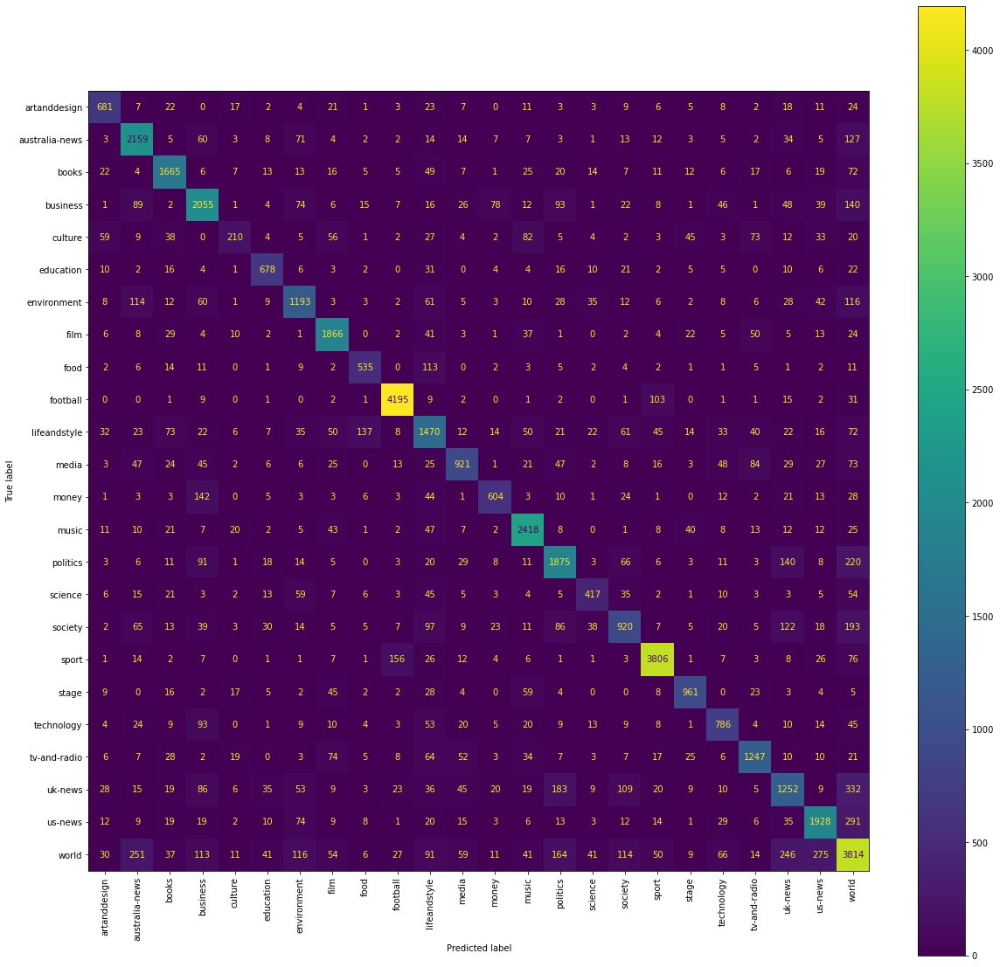

In [65]:
make_confusion_matrix(xgb_model, X250_test_vector_final, y250_test['sectionId'])

#### save model

In [25]:
with open('data/xgb_model.pkl', 'wb') as file:
    pickle.dump(xgb_model, file)


## Random Forest

### load from memory

In [33]:
#open pre-trained model
with open('data/rf_model.pkl', 'rb') as inp:
    rf_model = pickle.load(inp)

### from scratch

In [29]:
rf_model=RandomForestClassifier(n_estimators=100, verbose=True)
rf_model.fit(X250_train_vector_final, y250_train['sectionId'])
rf_model.score(X250_train_vector_final, y250_train['sectionId'])

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed: 72.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:   28.6s finished


1.0

In [30]:
rf_model.score(X250_test_vector_final, y250_test['sectionId'])

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    3.8s finished


0.73854

In [34]:
print(make_class_report(rf_model, X250_test_vector_final, y250_test['sectionId']))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    5.4s finished


                precision    recall  f1-score   support

  artanddesign      0.735     0.664     0.698       888
australia-news      0.711     0.900     0.794      2564
         books      0.755     0.822     0.787      2022
      business      0.654     0.771     0.708      2785
       culture      1.000     0.144     0.253       699
     education      0.810     0.727     0.767       858
   environment      0.693     0.598     0.642      1767
          film      0.741     0.894     0.810      2136
          food      0.768     0.669     0.715       732
      football      0.930     0.977     0.953      4377
  lifeandstyle      0.614     0.616     0.615      2285
         media      0.826     0.491     0.616      1476
         money      0.895     0.491     0.634       933
         music      0.772     0.924     0.841      2723
      politics      0.685     0.781     0.730      2555
       science      0.781     0.413     0.540       727
       society      0.683     0.446     0.539  

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    3.5s finished
<ipython-input-2-979cc80c55c4>:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.xaxis.set_ticklabels(x_list, rotation=45);


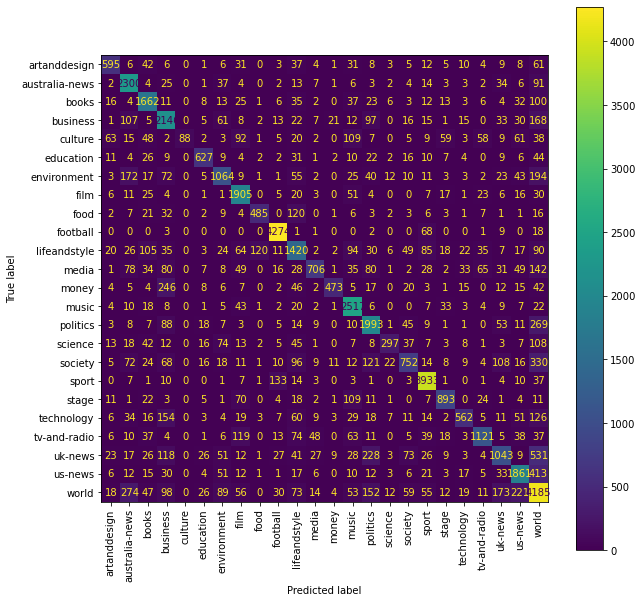

In [37]:
make_confusion_matrix(rf_model, X250_test_vector_final, y250_test['sectionId'])

#### save model

In [32]:
with open('data/rf_model.pkl', 'wb') as file:
    pickle.dump(rf_model, file)


# Word Embeddings Models, not NNs

In [ ]:
with open("data/data_words", "r") as fp:
    data = json.load(fp)

In [18]:
total_vocabulary = set(word for sublist in data for word in sublist)

## Make list of lists of all words in X_train, saved so can skip

In [14]:
data = X250_train['join_nostop'].map(word_tokenize).values

In [17]:
data=list(data)
with open("data/data_words", "w") as fp:
    json.dump(data, fp)

## Make vector

In [42]:
glove = {}
with open('data/glove.6B.50d.txt', 'rb') as f:
    for line in f:
        parts = line.split()
        word = parts[0].decode('utf-8')
        if word in total_vocabulary:
            vector = np.array(parts[1:], dtype=np.float32)
            glove[word] = vector

In [56]:
class W2vVectorizer(object):
    
    def __init__(self, w2v):
        self.w2v = w2v
        if len(w2v) == 0:
            self.dimensions = 0
        else:
            self.dimensions = len(w2v[next(iter(glove))])
    
    def fit(self, X, y):
        return self
            
    def transform(self, X):
        return np.array([
            np.mean([self.w2v[w] for w in words if w in self.w2v]
                   or [np.zeros(self.dimensions)], axis=0) for words in X])

In [46]:
rf =  Pipeline([('Word2Vec Vectorizer', W2vVectorizer(glove)),
              ('Random Forest', RandomForestClassifier(n_estimators=100, verbose=True))])
lr = Pipeline([('Word2Vec Vectorizer', W2vVectorizer(glove)),
              ('Logistic Regression', LogisticRegression())])
xgb = Pipeline([('Word2Vec Vectorizer', W2vVectorizer(glove)),
              ('Grad Boost', XGBClassifier())])

In [47]:
models = [('Random Forest', rf),
          ('Logistic Regression', lr),
          ('Grad Boost', xgb)]

In [57]:
scores = [(name, cross_val_score(model, data, y250_train['sectionId'], cv=2).mean()) for name, model, in models]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:  1.5min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    7.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:  1.5min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    8.8s finished
C:\Users\james\anaconda3\envs\learn-env\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative so

[20:41:59] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:52:12] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [58]:
scores

[('Random Forest', 0.701715),
 ('Logistic Regression', 0.69686),
 ('Grad Boost', 0.71888)]

# Neural nets

**The first NN model uses a learned embedding layer, so I needed to turn each row into an equal size vector of words. I found the most common 10k words across the whole set and then found the most common 200 words (max) in each row, assuming they belonged to the vocab. I turned these into tokenised vectors, and if there weren't 200 words, padded with zeros.**<br>
**I had to OHE the outputs, to give a 24d vector. I used similar model to the one in NLP apendix, with 128 dim embed layer, but adjusted to take into account the vocab size and output categories**<br>

In [2]:
labels_nn=['artanddesign', 'australia-news', 'books', 'business', 'culture', 'education', 'environment',
        'film', 'food', 'football', 'lifeandstyle', 'media', 'money', 'music', 'politics', 'science',
        'society', 'sport', 'stage', 'technology', 'tv-andradio', 'uk-news', 'us-news', 'world']

In [12]:
def makeLoflists(df, total_vocab, chunk_size, count=0):
    '''takes in dataframe and returns 10k most common words and list of list with max200 most common words
    in each article, if they are in the vocab '''
    data=[]
    raw_data = [x.split() for x in df]
    total_vocabulary = (word for article in raw_data for word in article)
    total_vocab_count = Counter(total_vocabulary)
    k2_vocab = [x[0] for x in total_vocab_count.most_common(total_vocab)]
    data_long =[]
    for sublist in raw_data:
        filt = [x for x in sublist if x in k2_vocab]
        data_long.append(filt)
    for sub in data_long:
        vocab = Counter(sub)
        vocab_200 = [x[0] for x in vocab.most_common(chunk_size)]
        data.append(vocab_200)
        count+=1
    return data, k2_vocab

In [7]:
def create_tokenized_padded(tokenizer, chunk_size, data):
    '''takes in list of word lists from the train set, turns them into sequences of token indices, then pads'''
    X_NN = tokenizer.texts_to_sequences(data)
    X_NN = pad_sequences(X_NN, maxlen=chunk_size)
    return X_NN

In [24]:
def make_tokenized_test(tokenizer, test_df, chunk_size, full_vocab, count=0):
    '''takes in test dataframe and returns padded tokenized list for each record'''
    data=[]
    raw_data = [x.split() for x in test_df]
    data_long = []
    for sublist in raw_data:
        filt = [x for x in sublist if x in full_vocab]
        data_long.append(filt)
    for sub in data_long:
        vocab = Counter(sub)
        vocab_200 = [x[0] for x in vocab.most_common(chunk_size)]
        data.append(vocab_200)
        count+=1
    X_NN = create_tokenized_padded(tokenizer, 300, data)
    return X_NN

**Here is the function for making the word embedding visualizations. Basically, we pass the learned embedding weights and a file containing the list of words in the vocabulary (metadata.tsv) into tensorflow's tensorboard plugin, and it plots them. The only tricky part is keeping track of the files and checkpoints required by the plugin, eg you have to delete the logs file and a temp file each time you want to run a new instance, or else it just keeps showing the previous plot**

In [3]:
def make_nntensor_viz(tokens, model_weights):
    
    '''make tensorboard viz of embedding matrix'''
    # clear logs before each call using  rm -rf logs on command line if running 2nd time...
    # kill tensorboard project before on cmd   taskkill /IM "tensorboard.exe" /F
    # manually remove "C:\Users\james\AppData\Local\Temp\.tensorboard-info"
    
    parent_dir = "C:/Users/james/Documents/Flatiron/p4_copy/"
    path = os.path.join(parent_dir, 'logs/')
    os.mkdir(path)


    weights = model_weights
    log_dir=f'C:/Users/james/Documents/Flatiron/p4_copy/logs/'
    checkpoint = tf.train.Checkpoint(embedding=weights)
    checkpoint.save(f'logs/embedding.ckpt')
    config = projector.ProjectorConfig()
    embedding = config.embeddings.add()
    voc_list = list(tokens.index_word.values())
    with open(f'logs/metadata.tsv', 'w', encoding="utf-8") as fp:
        for subwords in voc_list:
            fp.write("{}\n".format(subwords))

    embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
    embedding.metadata_path = 'metadata.tsv'

    return projector.visualize_embeddings(log_dir, config)

## Learned embedding

In [35]:
# can open from git
le_model = keras.models.load_model('data/le_nn')

### open files to make tensors, ignore of opening model directly

In [36]:
with open('data/token_10k.pkl', 'rb') as inp:
    tokenize_10k = pickle.load(inp)

In [37]:
with open('data/xle_train', 'rb') as inp:
    Xle_train = pickle.load(inp)

In [38]:
with open('data/xle_test', 'rb') as inp:
    Xle_test = pickle.load(inp)

### Make padded input tensors w 10k vocab and 300 word length/ saved so skip


In [40]:
ytr_ohe = pd.get_dummies(y250_train['cat_column']).values

In [41]:
yte_ohe = pd.get_dummies(y250_test['cat_column']).values

In [ ]:
dataLe, vocab10k = makeLoflists(X250_train['join_nostop'], 10000, 300)

In [13]:
tokenize_10k = Tokenizer()
tokenize_10k.fit_on_texts(dataLe)

In [14]:
with open('data/token_10k.pkl', 'wb') as outp:
    pickle.dump(tokenize_10k, outp, pickle.HIGHEST_PROTOCOL)

In [17]:
Xle_train = create_tokenized_padded(tokenize_10k, 300, dataLe)

In [18]:
with open('data/xle_train', 'wb') as outp:
    pickle.dump(Xle_train, outp, pickle.HIGHEST_PROTOCOL)

In [25]:
Xle_test = make_tokenized_test(tokenize_10k, X250_test['join_nostop'], 300, vocab10k)

In [26]:
with open('data/xle_test', 'wb') as outp:
    pickle.dump(Xle_test, outp, pickle.HIGHEST_PROTOCOL)

### fit model

In [14]:
le_model = Sequential()

In [28]:
embedding_size = 128
le_model.add(Embedding(10001, embedding_size))
le_model.add(LSTM(25, return_sequences=True))
le_model.add(GlobalMaxPool1D())
le_model.add(Dropout(0.5))
le_model.add(Dense(50, activation='relu'))
le_model.add(Dropout(0.5))
le_model.add(Dense(24, activation='softmax'))

In [29]:
le_model.compile(loss='categorical_crossentropy', 
              optimizer='adam', 
              metrics=['accuracy'])

In [30]:
Xle_train.shape

(200000, 300)

In [37]:
le_model.fit(Xle_train, ytr_ohe, epochs=40, batch_size=32, validation_split=0.1)

Epoch 1/40
5625/5625 [==============================] - 373s 66ms/step - loss: 1.9714 - accuracy: 0.3974 - val_loss: 1.2617 - val_accuracy: 0.6357
Epoch 2/40
5625/5625 [==============================] - 371s 66ms/step - loss: 1.4448 - accuracy: 0.5798 - val_loss: 1.0549 - val_accuracy: 0.7118
Epoch 3/40
5625/5625 [==============================] - 373s 66ms/step - loss: 1.2856 - accuracy: 0.6320 - val_loss: 0.9801 - val_accuracy: 0.7316
Epoch 4/40
5625/5625 [==============================] - 374s 66ms/step - loss: 1.2017 - accuracy: 0.6597 - val_loss: 0.9511 - val_accuracy: 0.7408
Epoch 5/40
5625/5625 [==============================] - 367s 65ms/step - loss: 1.1344 - accuracy: 0.6779 - val_loss: 0.9335 - val_accuracy: 0.7463
Epoch 6/40
5625/5625 [==============================] - 357s 63ms/step - loss: 1.0879 - accuracy: 0.6920 - val_loss: 0.9259 - val_accuracy: 0.7501
Epoch 7/40
5625/5625 [==============================] - 357s 64ms/step - loss: 1.0445 - accuracy: 0.7039 - val_loss: 0

### Save model

In [39]:
le_model.save('data/le_nn')

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: data/le_nn\assets


### test

In [40]:
print("Evaluate on test data")
results = le_model.evaluate(Xle_test, yte_ohe, batch_size=20)
print("test loss, test acc:", results)


Evaluate on test data
2500/2500 [==============================] - 37s 15ms/step - loss: 1.4760 - accuracy: 0.7459
test loss, test acc: [1.4760349988937378, 0.7459200024604797]


In [69]:
pred_le = le_model.predict(Xle_test)

In [63]:
le_preds=[]
for r in pred_le:
    pred = labels_nn[(list(r)).index(np.max(r))]
    le_preds.append(pred)

In [68]:
print(classification_report(y250_test['sectionId'], le_preds, digits=3))

                precision    recall  f1-score   support

  artanddesign      0.587     0.775     0.668       888
australia-news      0.770     0.810     0.790      2564
         books      0.839     0.745     0.789      2022
      business      0.784     0.676     0.726      2785
       culture      0.535     0.186     0.276       699
     education      0.759     0.720     0.739       858
   environment      0.562     0.759     0.646      1767
          film      0.840     0.807     0.823      2136
          food      0.767     0.643     0.700       732
      football      0.955     0.976     0.966      4377
  lifeandstyle      0.584     0.610     0.597      2285
         media      0.730     0.667     0.697      1476
         money      0.607     0.662     0.634       933
         music      0.844     0.883     0.863      2723
      politics      0.741     0.719     0.730      2555
       science      0.627     0.480     0.544       727
       society      0.499     0.639     0.561  

FixedFormatter should only be used together with FixedLocator
FixedFormatter should only be used together with FixedLocator


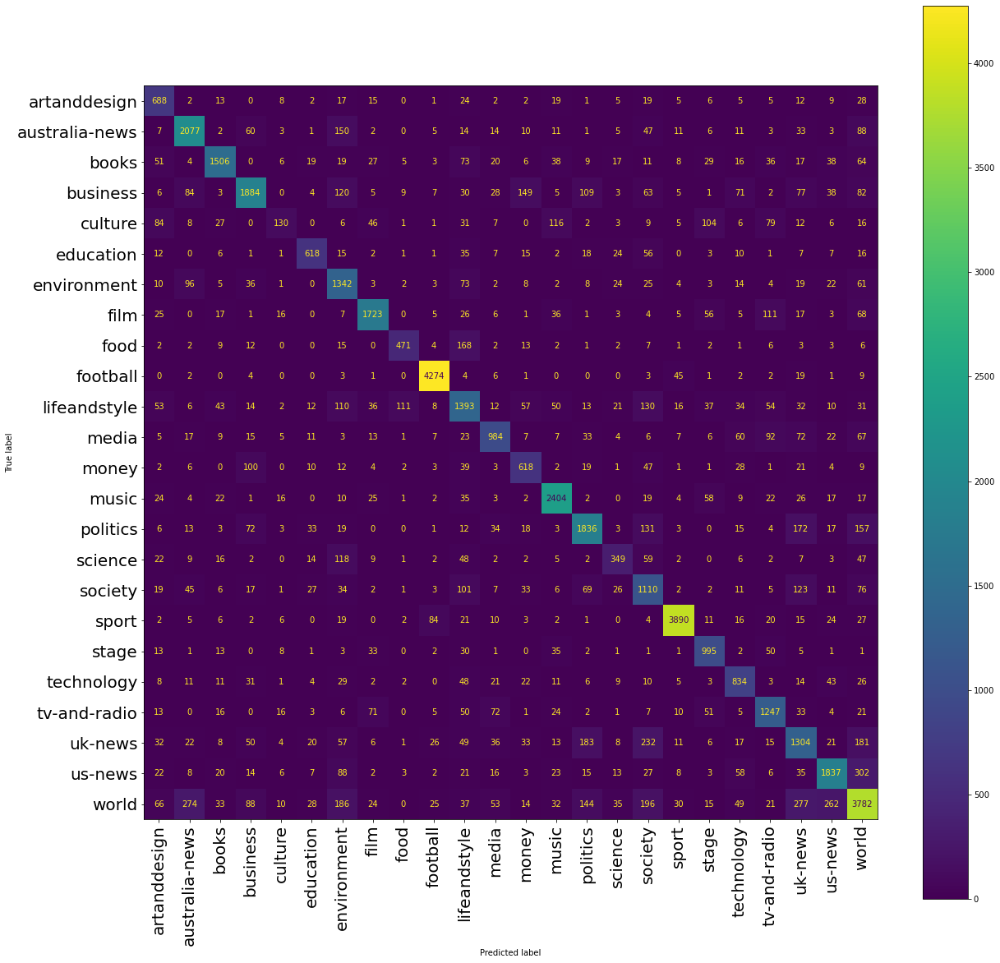

In [72]:
cm = confusion_matrix(y250_test['sectionId'], le_preds)
cmp = ConfusionMatrixDisplay(confusion_matrix=cm,
                             display_labels=labels_nn)
x_list = labels_nn
fig, ax = plt.subplots(figsize=(20,20))
ax.yaxis.set_ticklabels(x_list, fontsize=20);
ax.xaxis.set_ticklabels(x_list, rotation=45, fontsize=20);
cmp.plot(ax=ax, xticks_rotation='vertical')

**The 2nd NN model used the pre-trained glove 100d W2Vec matrix as the embedding layer. Due to the extra CPU and memory needs, I limited it to 2k total vocabulary, and extracted the glove values for each word and made the embed matrix using these**<br>
**Instead of OHE the output, I used the 'sparse_categorical_crossentropy' loss function, which can handle the categories represented as numbers in one column in the y_df**<br>
**The model takes in a 200word vector and activates those weights in the embed matrix, so we need to follow the same process as above to produce the input vector**


### Use Tensorboard projection to visualize learned embedding matrix

In [ ]:
# clear logs before each call using  rm -rf logs on gitbash command line 
# if running 2nd time...
# kill tensorboard project before on cmd   taskkill /IM "tensorboard.exe" /F
# manually remove "C:\Users\james\AppData\Local\Temp\.tensorboard-info"

In [6]:
mw = tf.Variable(le_model.layers[0].get_weights()[0][1:], name='weights')

In [7]:
make_nntensor_viz(tokenize_10k, mw)

In [ ]:
%tensorboard --logdir /Users/james/Documents/Flatiron/p4_copy/logs/

## NN glove

In [73]:
nn_model = keras.models.load_model('data/glove_nn')

### Load tensors, can skip and load model directly instead

In [74]:
with open('data/token_2k.pkl', 'rb') as inp:
    tokenize_2k = pickle.load(inp)

In [75]:
with open('data/xnn_train', 'rb') as inp:
    Xnn_train = pickle.load(inp)

In [76]:
with open('data/xnn_test', 'rb') as inp:
    Xnn_test = pickle.load(inp)

### Make test and train tensors, 200 words from 2000 total vocab/save so can skip

In [ ]:
data200, vocab2k = makeLoflists(X250_train['join_nostop'], 2000, 200)

In [ ]:
tokenize_2k = Tokenizer()
tokenize_2k.fit_on_texts(data200)

In [113]:
with open('data/token_2k.pkl', 'wb') as outp:
    pickle.dump(tokenize_2k, outp, pickle.HIGHEST_PROTOCOL)

In [115]:
Xnn_train = create_tokenized_padded(tokenize_2k, data200)

In [120]:
with open('data/xnn_train', 'wb') as outp:
    pickle.dump(Xnn_train, outp, pickle.HIGHEST_PROTOCOL)

In [ ]:
Xnn_test = make_tokenized_test(tokenize_2k, X250_test['join_nostop'])

In [129]:
with open('data/xnn_test', 'wb') as outp:
    pickle.dump(Xnn_test, outp, pickle.HIGHEST_PROTOCOL)

### Make embed matrix

In [25]:
vocab2k = list(tokenize_2k.word_index.keys())
len(vocab2k)

2000

In [26]:
glove_nn = {}
with open('data/glove.6B.100d.txt', 'rb') as f:
    for line in f:
        parts = line.split()
        word = parts[0].decode('utf-8')
        if word in vocab2k:
            vector = np.array(parts[1:], dtype=np.float32)
            glove_nn[word] = vector

In [27]:
embedding_matrix = np.zeros((2001, 100))
no_glove=[]
for word, index in tokenize_2k.word_index.items():
    try:
        embedding_matrix[index] = glove_nn[word]
    except:
        no_glove.append(word)

### Make/fit model

In [15]:
from keras.models import Input, Model
from keras.layers import LSTM, Dense, Embedding, concatenate, Dropout, concatenate
from keras.layers import Bidirectional

inp1 = Input(shape=(200,))
x = Embedding(2001, 100, weights=[embedding_matrix])(inp1)
x = Bidirectional(LSTM(256, return_sequences=True))(x)
x = Bidirectional(LSTM(150))(x)
x = Dense(128, activation="relu")(x)
x = Dropout(0.1)(x)
x = Dense(64, activation="relu")(x)
x = Dense(24, activation="softmax")(x)    
nn_model = Model(inputs=inp1, outputs=x)


In [23]:
nn_model.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

In [26]:
nn_model.fit(Xnn_train, y250_train['cat_column'], epochs=1, batch_size=150, validation_split=0.1)


1200/1200 [==============================] - 6518s 5s/step - loss: 0.6128 - accuracy: 0.8055 - val_loss: 0.7061 - val_accuracy: 0.7839


### Save model

In [34]:
nn_model.save('data/glove_nn')

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: glove_nn\assets


### Evaluate model

In [37]:
results = nn_model.evaluate(Xnn_test, y250_test['cat_column'], batch_size=128)
print("test loss, test acc:", results)

391/391 [==============================] - 477s 1s/step - loss: 0.7185 - accuracy: 0.7802
test loss, test acc: [0.7185116410255432, 0.7801799774169922]


In [49]:
labels_nn=['artanddesign', 'australia-news', 'books', 'business', 'culture', 'education', 'environment',
        'film', 'food', 'football', 'lifeandstyle', 'media', 'money', 'music', 'politics', 'science',
        'society', 'sport', 'stage', 'technology', 'tv-andradio', 'uk-news', 'us-news', 'world']

In [78]:
base_predictions = nn_model.predict(Xnn_test)

In [82]:
preds_nn=[]
for pred in base_predictions:
    pred=list(pred)
    max_index = pred.index(max(pred))
    preds_nn.append(labels_nn[max_index])

In [83]:
print(classification_report(y250_test['sectionId'], preds_nn, digits=3))

                precision    recall  f1-score   support

  artanddesign      0.697     0.776     0.734       888
australia-news      0.787     0.855     0.819      2564
         books      0.780     0.846     0.812      2022
      business      0.776     0.713     0.743      2785
       culture      0.642     0.318     0.425       699
     education      0.790     0.805     0.797       858
   environment      0.640     0.745     0.689      1767
          film      0.814     0.894     0.852      2136
          food      0.730     0.717     0.724       732
      football      0.939     0.985     0.962      4377
  lifeandstyle      0.631     0.726     0.675      2285
         media      0.735     0.703     0.718      1476
         money      0.720     0.721     0.721       933
         music      0.867     0.889     0.878      2723
      politics      0.749     0.768     0.758      2555
       science      0.724     0.604     0.659       727
       society      0.675     0.544     0.603  

In [ ]:
cm = confusion_matrix(y250_test['cat_column'], preds_nn)
cmp = ConfusionMatrixDisplay(confusion_matrix=cm, 
                              display_labels=labels_nn)

<ipython-input-69-48453ea34587>:3: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.xaxis.set_ticklabels(x_list, rotation=45, fontsize=20);
<ipython-input-69-48453ea34587>:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.yaxis.set_ticklabels(x_list, fontsize=20);


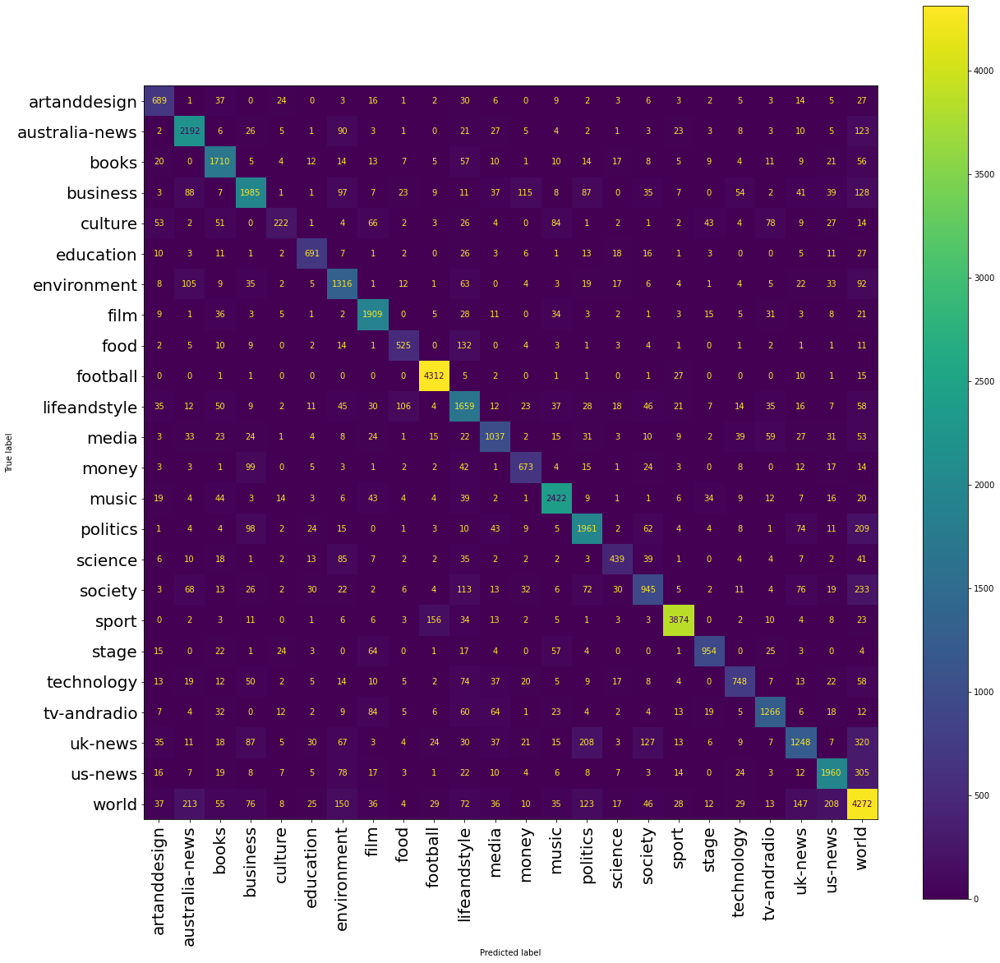

In [69]:
x_list = labels_nn
fig, ax = plt.subplots(figsize=(20,20))
ax.xaxis.set_ticklabels(x_list, rotation=45, fontsize=20);
ax.yaxis.set_ticklabels(x_list, fontsize=20);
cmp.plot(ax=ax, xticks_rotation='vertical')
plt.savefig("glove_nn_cf.png")

### Use Tensorboard projection to visualize W2V trained matrix

In [ ]:
# clear logs before each call using  rm -rf logs on gitbash command line 
# if running 2nd time...
# kill tensorboard project before on cmd   taskkill /IM "tensorboard.exe" /F
# manually remove "C:\Users\james\AppData\Local\Temp\.tensorboard-info"

In [20]:
nnw = tf.Variable(nn_model.layers[1].get_weights()[0][1:], name='weights')

In [21]:
make_nntensor_viz(tokenize_2k, nnw)

In [ ]:
%tensorboard --logdir /Users/james/Documents/Flatiron/p4_copy/logs/

### Use Tensorboard projection to visualize W2V original embeddings

In [ ]:
# clear logs before each call using  rm -rf logs on gitbash command line 
# if running 2nd time...
# kill tensorboard project before on cmd   taskkill /IM "tensorboard.exe" /F
# manually remove "C:\Users\james\AppData\Local\Temp\.tensorboard-info"

In [28]:
w2vw = tf.Variable(embedding_matrix[1:], name='weights')

In [29]:
make_nntensor_viz(tokenize_2k, w2vw)

In [ ]:
%tensorboard --logdir /Users/james/Documents/Flatiron/p4_copy/logs/

# Wordclouds

In [51]:
from PIL import Image

def make_wordcloud(mask_file, save_file, word_string):
    mask = np.array(Image.open(mask_file))
    wordcloud = WordCloud(background_color="white", width=800, height=400, mask=mask, contour_width=3, min_font_size=12, contour_color='black')
    wordcloud.generate(word_string)
    wordcloud.to_file(save_file)
    fig, ax = plt.subplots(figsize=(20, 20))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.figure()
    plt.imshow(mask, cmap=plt.cm.gray, interpolation='bilinear')
    plt.axis("off")
    plt.show()


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


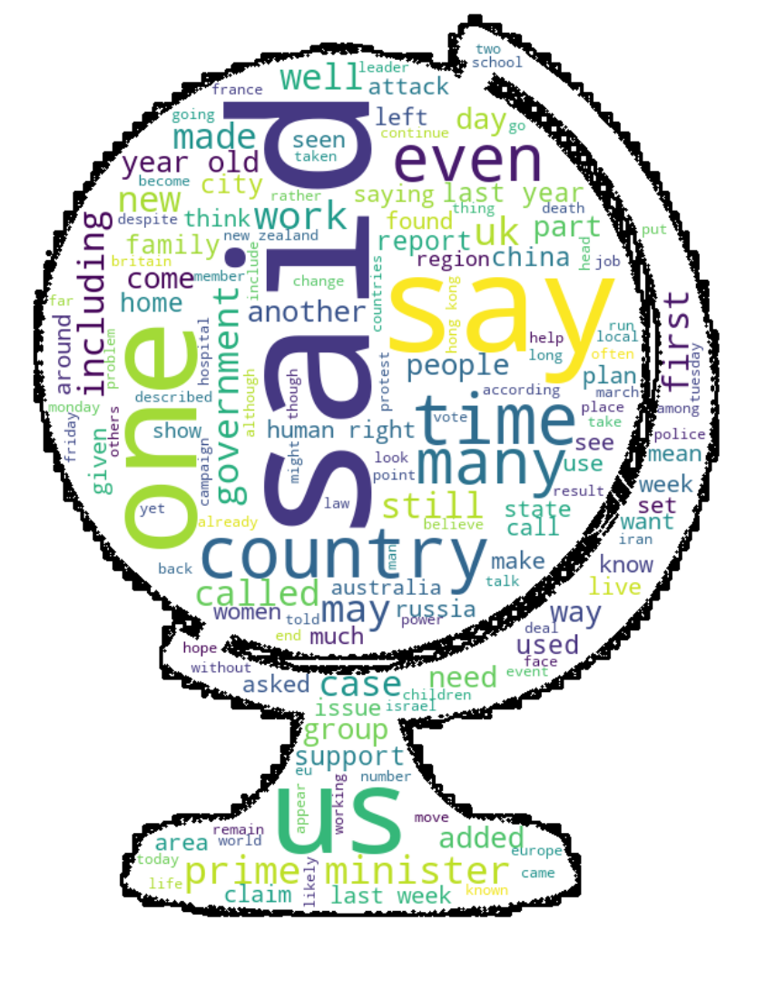

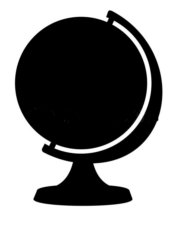

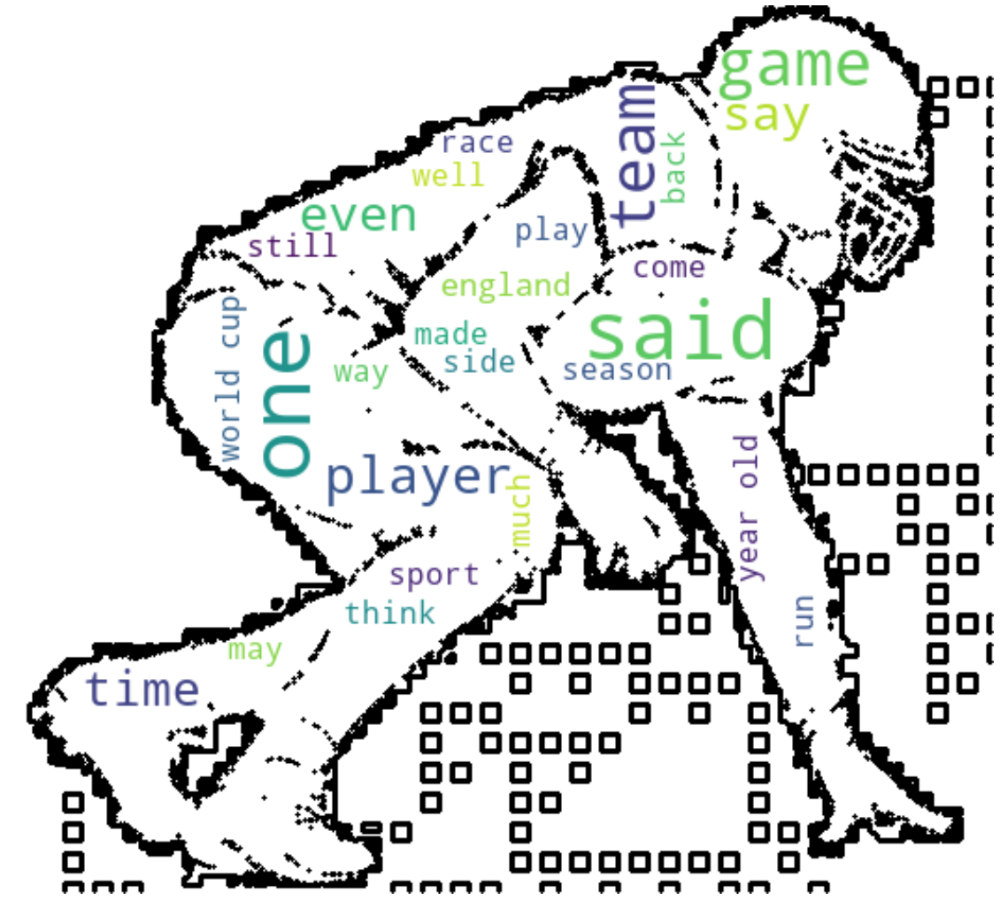

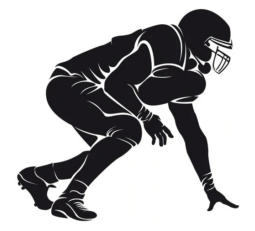

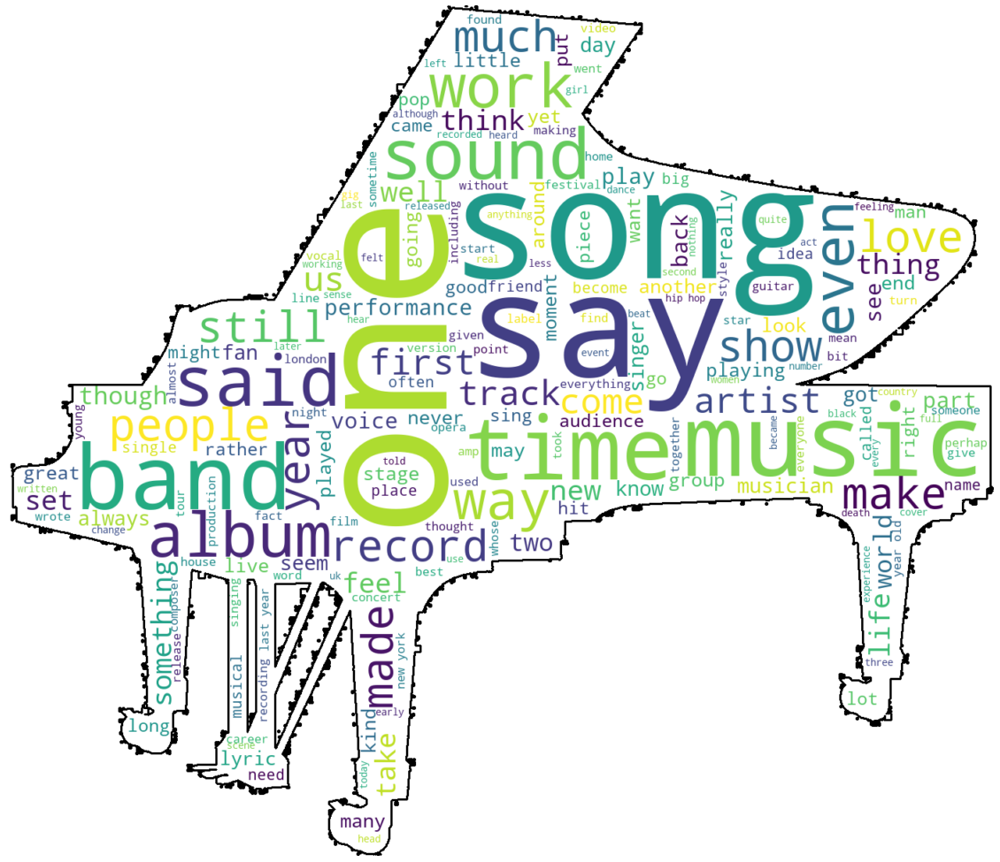

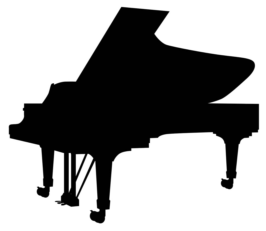

In [57]:
mask_dic = {'world': 'images/globe.jpg', 'sport': 'images/AmFbl.jpg', 'music': 'images/piano.jpg'}
for cat in mask_dic:
    mask_file=mask_dic[cat]
    save_file=f"Viz/{cat}_wc.png"
    indices = y250_train[y250_train['sectionId'] == cat].index.tolist()
    temp_df = X250_train.iloc[indices]
    temp_df['split'] = temp_df['join_nostop'].map(lambda x: x.split())
    word_list = temp_df['split'].explode().tolist()
    word_string=" ".join(word_list)
    make_wordcloud(mask_file, save_file, word_string)
        

# Summary table of model performance

In [47]:
pd1=[['Sample10k','Sample10k','Sample10k','Sample10k','Sample10k','Sample10k','Sample10k','Sample10k','Sample10k',
      'Sample10k','Sample10k','Sample10k','Sample10k','Sample10k','Sample10k',
     'FullSet','FullSet','FullSet','FullSet','FullSet','FullSet','FullSet','FullSet','FullSet'],
     ['tf/idf', 'tf/idf', ' tf/idf', 'tf/idf', 'tf/idf', 'tf/idf', 'tf/idf', 'tf/idf', 'tf/idf', 'tf/idf', 'tf/idf',
     'WordEmbedding','WordEmbedding','WordEmbedding','WordEmbedding',
     'tf/idf', 'tf/idf','tf/idf','tf/idf',
    'WordEmbedding','WordEmbedding','WordEmbedding','WordEmbedding','WordEmbedding'],
     ['Naive-Bayes', 'Naive-Bayes','Naive-Bayes','Naive-Bayes','Naive-Bayes','Naive-Bayes','Naive-Bayes',
     'Logistic', 'RandomForest', 'SupportVector', 'GradientBoost', 
      'RandomForest', 'SupportVector', 'Logistic', 'GradientBoost',
     'Naive-Bayes', 'Logistic', 'GradientBoost', 'RandomForest', 'RandomForest',
      'Logistic', 'GradientBoost', 'NeuralNet', 'NeuralNet'],
     ['Baseline', 'Stopword', 'Stemmed', 'NumSent','TunedMaxFeatures', 'SpecialWords', 'Bigrams', 'SpecialWords', 
      'SpecialWords','SpecialWords','SpecialWords', 'W2V50d', 'W2V50d','W2V50d','W2V50d', 
      'StopStemTuned', 'StopStemTuned','StopStemTuned','StopStemTuned', 'W2V50d','W2V50d','W2V50d','W2V100d',
      'SelfLearning'],
    [54, 64.7, 65.7, 65.5, 65.6, 66.9, 53, 71.9, 64.7, 71.1, 69, 63.4, 63.4, 66, 64.1,
     72.2, 78.9, 75.3, 73,70.2,69.7,71.9,78, 74.6]
    ]

In [48]:
sum_df=pd.DataFrame(pd1).transpose()
sum_df.columns=['SampleSet', 'VectorizationType',
                                 'Model', 'ProcessedVector', 'Accuracy (%)']
sum_df=sum_df.sort_values(by='Accuracy (%)', ascending=False)

In [49]:
sum_df

,SampleSet,VectorizationType,Model,ProcessedVector,Accuracy (%)
16,FullSet,tf/idf,Logistic,StopStemTuned,78.9
22,FullSet,WordEmbedding,NeuralNet,W2V100d,78
17,FullSet,tf/idf,GradientBoost,StopStemTuned,75.3
23,FullSet,WordEmbedding,NeuralNet,SelfLearning,74.6
18,FullSet,tf/idf,RandomForest,StopStemTuned,73
15,FullSet,tf/idf,Naive-Bayes,StopStemTuned,72.2
7,Sample10k,tf/idf,Logistic,SpecialWords,71.9
21,FullSet,WordEmbedding,GradientBoost,W2V50d,71.9
9,Sample10k,tf/idf,SupportVector,SpecialWords,71.1
19,FullSet,WordEmbedding,RandomForest,W2V50d,70.2
